In [1]:
from google.colab import drive
drive.mount('/content/drive')

%cd /content/drive/MyDrive/BDS500/Notebooks

Mounted at /content/drive
/content/drive/MyDrive/BDS500/Notebooks


In [2]:
import os
import numpy as np

# Load the image chunks
BASE_DIR = os.path.join('/content', 'drive', 'MyDrive', 'BDS500')
PROC_IMAGE_DIR = os.path.join(BASE_DIR, 'Processed Images')
PROC_CHUNKS_FILE = os.path.join(PROC_IMAGE_DIR, 'bsds_300_chunks.npy')

bsds_300_chunks = np.load(PROC_CHUNKS_FILE)

# Shuffle the images
N = bsds_300_chunks.shape[0]
permutation = np.random.permutation(N)
bsds_300_chunks = bsds_300_chunks[permutation]

print('bsds_300_chunks.shape: {}'.format(bsds_300_chunks.shape))

bsds_300_chunks.shape: (30000, 32, 32, 3)


/content/drive/My Drive/BDS500/Notebooks/utils/plotting.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(rows, cols, image_idx + 1)


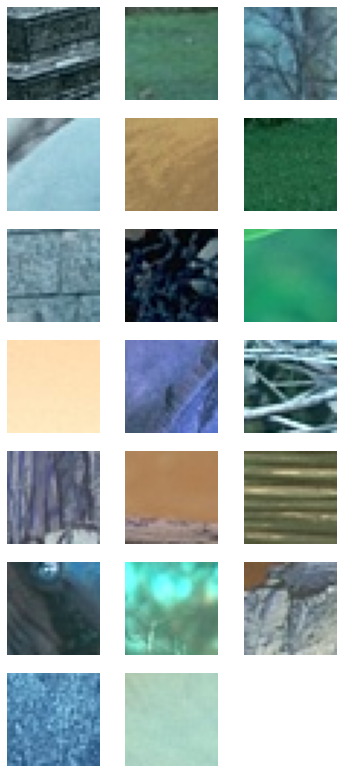

In [3]:
from utils.plotting import *

# Plot the image chunks
to_display = 20
plot_images(bsds_300_chunks[-to_display:])

blurred_low_res_bsds_300_chunks.shape: (30000, 16, 16, 3)


/content/drive/My Drive/BDS500/Notebooks/utils/plotting.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(rows, cols, image_idx + 1)


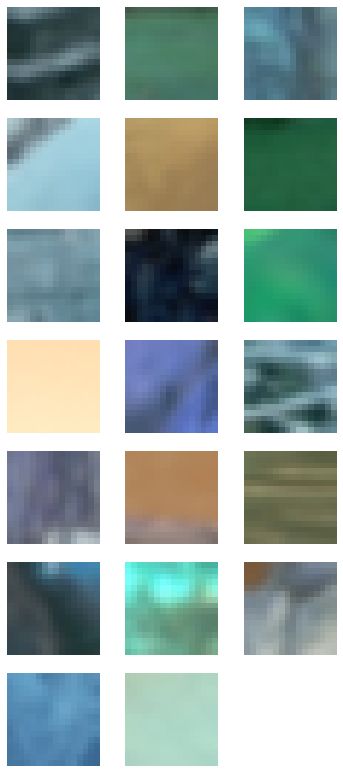

In [4]:
# Load the blurred low-res data
BLUR_LR_CHUNKS_FILE = os.path.join(PROC_IMAGE_DIR, 'blurred_low_res_bsds_300_chunks.npy')

blurred_low_res_bsds_300_chunks = np.load(BLUR_LR_CHUNKS_FILE)

# Shuffle the images in the same order
blurred_low_res_bsds_300_chunks = blurred_low_res_bsds_300_chunks[permutation]

print('blurred_low_res_bsds_300_chunks.shape: {}'.format(blurred_low_res_bsds_300_chunks.shape))

# Plot the low-res image chunks
plot_images(blurred_low_res_bsds_300_chunks[-to_display:])

ifan_chunks.shape: (30000, 16, 16, 3)


/content/drive/My Drive/BDS500/Notebooks/utils/plotting.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(rows, cols, image_idx + 1)


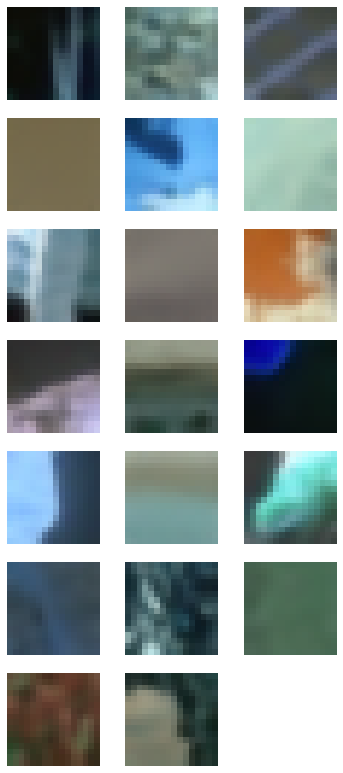

In [5]:
# Load the IFAN data
IFAN_CHUNKS_FILE = os.path.join(PROC_IMAGE_DIR, 'ifan_chunks.npy')

ifan_chunks = np.load(IFAN_CHUNKS_FILE)

# Shuffle the images in the same order
ifan_chunks = ifan_chunks[permutation]

print('ifan_chunks.shape: {}'.format(ifan_chunks.shape))

# Plot the low-res image chunks
plot_images(ifan_chunks[-to_display:])

interpolated_chunks.shape: (30000, 32, 32, 3)


/content/drive/My Drive/BDS500/Notebooks/utils/plotting.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(rows, cols, image_idx + 1)


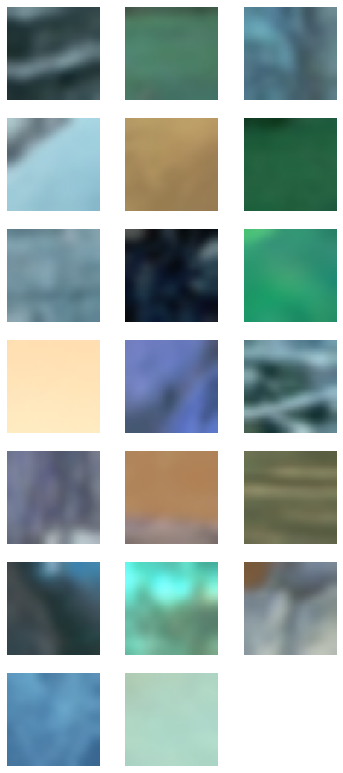

In [6]:
from utils.preprocessing import *

# Generate interpolated images with cubic interpolation from low-res images
interpolated_chunks = resize_images(blurred_low_res_bsds_300_chunks, scale=2.0, mode='cubic') # Train SRCNN on BSDS 300 data

print('interpolated_chunks.shape: {}'.format(interpolated_chunks.shape))

# Plot the interpolated image chunks
plot_images(interpolated_chunks[-to_display:])

In [7]:
import torch
import torch.optim as optim
from models.srcnn import SRCNN

# Use the GPU is available else use CPU
device = torch.device('cpu')
if torch.cuda.is_available():
    device = torch.device('cuda')

print('Using: {}'.format(device))

learning_rate = 1e-3 #1e-2 / 5 #255.
weight_decay = 1e-3
model = SRCNN()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

Using: cuda


In [8]:
import torch.nn.functional as F

def get_loss(model, X, Y):
    loss = np.inf
    with torch.no_grad():
        # Do the forward pass on vallidation set
        Y_hat = model(X)

        # Crop the predicted images
        Y_hat_crop = Y_hat[:, :, 6: 26, 6: 26]

        # Crop the validation images 
        Y_crop = Y[:, :, 6: 26, 6: 26]
        
        # Calculate the loss
        loss = F.mse_loss(Y_hat_crop, Y_crop)
    return loss

def train_srcnn(model, optimizer, train_data, val_data, batch_size, save_path, \
                epochs=1, print_every=10, chkpt_every=100, device=None):
    # Move the model parameters to the proper device (GPU or CPU)
    model = model.to(device=device)  

    # Unpack train and validation data
    X_train, Y_train = train_data
    X_val, Y_val = val_data

    # Move the data to the proper device (GPU or CPU)
    X_train = X_train.to(device=device)
    Y_train = Y_train.to(device=device)
    X_val = X_val.to(device=device)
    Y_val = Y_val.to(device=device)

    # Lists to store losses
    train_loss_history = []
    val_loss_history = []

    N = X_train.shape[0]
    for e in range(epochs):
        print('Epoch: {}'.format(e))
        batch_positions = range(0, N, batch_size)
        for i, batch_pos in enumerate(batch_positions):
            X_batch = X_train[batch_pos:batch_pos + batch_size]
            Y_batch = Y_train[batch_pos:batch_pos + batch_size]
            
            permutation = torch.randperm(X_train.size(0))
            batch_idx = permutation[:batch_size]
            X_batch = X_train[batch_idx]
            Y_batch = Y_train[batch_idx]

            model.train()  # put model to training mode

            Y_hat_batch = model(X_batch)
            
            # Don't calculate MSE for border pixels
            # The SRCNN model output is 20 x 20 in size
            Y_batch_crop = Y_batch[:, :, 6: 26, 6: 26]

            loss = F.mse_loss(Y_hat_batch, Y_batch_crop)

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()

            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            # Put model to evaluation mode
            model.eval()

            if i % print_every == 0:
                # Calculate validation loss
                val_loss = get_loss(model, X_val, Y_val)
                
                print('Iteration {}, train_loss = {:.8f}, val_loss: {:.8f}'.format(i, loss.item(), val_loss.item()))

            if (i + 1) % chkpt_every == 0:
                # Calculate validation loss
                val_loss = get_loss(model, X_val, Y_val)

                # Append train and validation loss
                train_loss_history.append(loss.item())
                val_loss_history.append(val_loss.item())

                # Save the trained model's weights with other info
                torch.save({
                        'epoch': e,
                        'model_state_dict': model.state_dict(),
                        'optimizer_state_dict': optimizer.state_dict()
                    }, save_path
                )

    return np.array(train_loss_history), np.array(val_loss_history)          

In [9]:
# Rescale all pixel values from 0-255 to 0-1
rescaled_interpolated_chunks = interpolated_chunks / 1.
rescaled_bsds_300_chunks = bsds_300_chunks / 1.

# Change the channel axis location
rescaled_interpolated_chunks = np.transpose(rescaled_interpolated_chunks, (0, 3, 1, 2))
rescaled_bsds_300_chunks = np.transpose(rescaled_bsds_300_chunks, (0, 3, 1, 2))

# Split the dataset into train and validation sets
num_train = int(N * 0.9)    # Use 90% data for training and the rest for validation
X_train = rescaled_interpolated_chunks[:num_train]
Y_train = rescaled_bsds_300_chunks[:num_train]

X_val = rescaled_interpolated_chunks[num_train:]
Y_val = rescaled_bsds_300_chunks[num_train:]

In [10]:
# Convert the data to PyTorch tensors
X_train_tensor = torch.from_numpy(X_train).float()
Y_train_tensor = torch.from_numpy(Y_train).float()
X_val_tensor = torch.from_numpy(X_val).float()
Y_val_tensor = torch.from_numpy(Y_val).float()

# File to save trained model weights to
CHKPT_FILE = os.path.join(BASE_DIR, 'Notebooks', 'models', 'SRCNN.pt')

train_loss_history, val_loss_history = train_srcnn(model, optimizer, train_data=(X_train_tensor, Y_train_tensor), val_data=(X_val_tensor, Y_val_tensor), \
            batch_size=1000, save_path=CHKPT_FILE, epochs=20, print_every=10, \
            chkpt_every=10, device=device)

Epoch: 0
Iteration 0, train_loss = 14340.80957031, val_loss: 10142.09082031
Iteration 10, train_loss = 3864.34399414, val_loss: 3553.89233398
Iteration 20, train_loss = 992.42889404, val_loss: 1077.30529785
Epoch: 1
Iteration 0, train_loss = 825.39477539, val_loss: 744.78240967
Iteration 10, train_loss = 559.26141357, val_loss: 557.97247314
Iteration 20, train_loss = 434.25296021, val_loss: 432.64517212
Epoch: 2
Iteration 0, train_loss = 401.77508545, val_loss: 384.02227783
Iteration 10, train_loss = 351.83624268, val_loss: 339.68505859
Iteration 20, train_loss = 312.12313843, val_loss: 298.36968994
Epoch: 3
Iteration 0, train_loss = 289.97659302, val_loss: 277.84201050
Iteration 10, train_loss = 282.39138794, val_loss: 257.92666626
Iteration 20, train_loss = 258.16128540, val_loss: 243.30749512
Epoch: 4
Iteration 0, train_loss = 239.12324524, val_loss: 235.51254272
Iteration 10, train_loss = 239.07147217, val_loss: 227.33055115
Iteration 20, train_loss = 218.01789856, val_loss: 220.57

Model Parameters:
conv1.weight 	 torch.Size([64, 3, 9, 9])
conv1.bias 	 torch.Size([64])
conv2.weight 	 torch.Size([32, 64, 1, 1])
conv2.bias 	 torch.Size([32])
conv3.weight 	 torch.Size([3, 32, 5, 5])
conv3.bias 	 torch.Size([3])
high_res_bsds_300_chunks.shape: (20, 32, 32, 3)


/content/drive/My Drive/BDS500/Notebooks/utils/plotting.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(rows, cols, image_idx + 1)


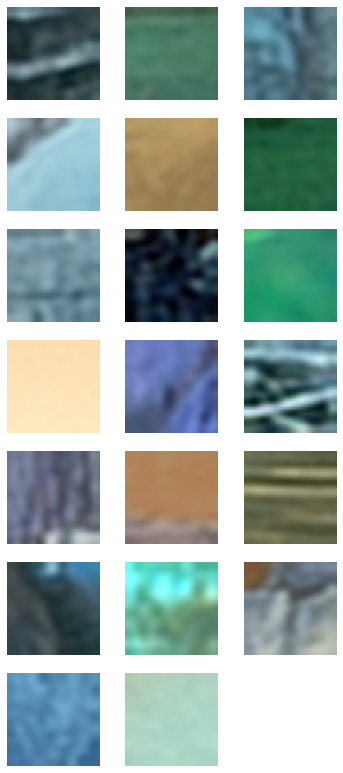

In [11]:
# Load the saved model
checkpoint = torch.load(CHKPT_FILE)

model = SRCNN()
model.load_state_dict(checkpoint['model_state_dict'])

# Convert model to evaluation mode
model.eval()

# Display model parameters
print("Model Parameters:")
for param_tensor in model.state_dict():
    print(param_tensor, "\t", model.state_dict()[param_tensor].size())

# Generate high-res image chunks from the interpolated chunks
high_res_bsds_300_tensor = model(X_val_tensor[-to_display:])

# Convert the PyTorch tensor to a numpy array
high_res_bsds_300_chunks = high_res_bsds_300_tensor.detach().numpy()
high_res_bsds_300_chunks = np.transpose(high_res_bsds_300_chunks, (0, 2, 3, 1))

# Rescale the values to between 0 and 255
high_res_bsds_300_chunks = 1. * high_res_bsds_300_chunks 

print('high_res_bsds_300_chunks.shape: {}'.format(high_res_bsds_300_chunks.shape))

# Plot a few of the high-res images
plot_images(high_res_bsds_300_chunks[-to_display:])

In [12]:
from utils.metrics import *

# Print the PSNR score for the model
print('PSNR: {}'.format(psnr(bsds_300_chunks[-to_display:], high_res_bsds_300_chunks)))

PSNR: 25.58405563164523


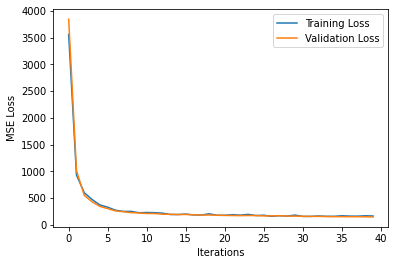

In [13]:
# Plot training loss and validation loss
x_range = np.arange(train_loss_history.shape[0])
plt.plot(x_range, train_loss_history, label='Training Loss')
plt.plot(x_range, val_loss_history, label='Validation Loss')
plt.legend()
plt.xlabel('Iterations')
plt.ylabel('MSE Loss')
plt.show()

Preprocessing test data ...
Plotting images


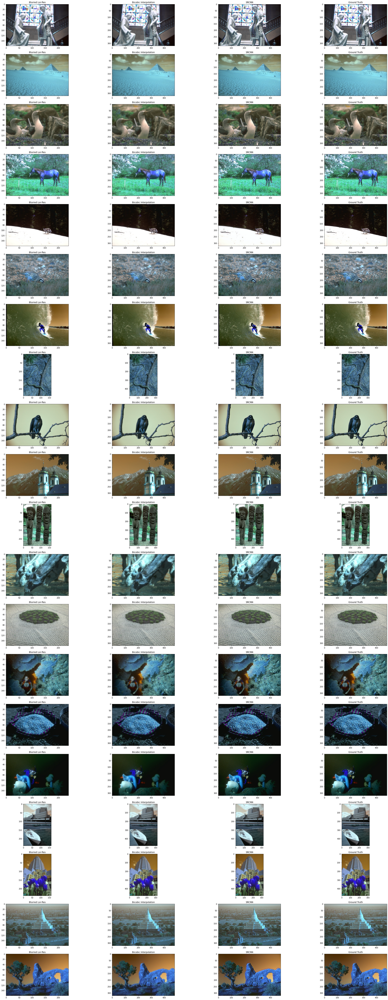

In [ ]:
# Load the test images
BASE_DIR = os.path.join('/content', 'drive', 'MyDrive', 'BDS500')
TEST_IMAGE_DIR = os.path.join(BASE_DIR, 'BSDS300-images', 'BSDS300', 'images', 'test')

test_images = get_bsds_300_test_images(TEST_IMAGE_DIR)

# Load the saved model
CHKPT_FILE = os.path.join(BASE_DIR, 'Notebooks', 'models', 'SRCNN.pt')
checkpoint = torch.load(CHKPT_FILE)

model = SRCNN()
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

# Preprocess the test images
print('Preprocessing test data ...')
cropped_test_images = []
lr_images = []
interpolated_images = []
preprocessed_test_images = []
hr_images = []
for image in test_images:
    H, W, _ = image.shape
    
    # Drop the last row and column since BSDS data
    # has odd number of rows and columns
    image = image[:-1, :-1, :]
    cropped_test_images.append(image)

    # Apply Gaussian Blur
    blur_image = cv2.GaussianBlur(image, (3, 3), 0)

    # Convert them to low res
    scale = 0.5
    H_low = int(H * scale)
    W_low = int(W * scale)

    lr_image = cv2.resize(blur_image, dsize=(W_low, H_low), fx=scale, fy=scale)
    lr_images.append(lr_image)

    # Apply cubic interpilcation
    scale = 2.0
    H_high = int(H_low * scale)
    W_high = int(W_low * scale)

    interpolated_image = cv2.resize(lr_image, dsize=(W_high, H_high), \
                                    fx=scale, fy=scale)
    interpolated_images.append(interpolated_image)

    # Rescale the image
    rescaled_image = interpolated_image / 1.

    # Swap axes
    axes_swapped_image = np.transpose(rescaled_image, (2, 0, 1))

    # Add an axes since the model takes 4d input
    processed_test_image = np.expand_dims(axes_swapped_image, axis=0)

    # Convert to PyToch tensor
    processed_tensor = torch.from_numpy(processed_test_image).float()

    # Add the processed image to the list
    preprocessed_test_images.append(processed_tensor)

    # Forward pass through SRCNN / Convert each test image to high-res using the SRCNN
    hr_tensor = model(processed_tensor)

    # Convert back to numpy array and adjust channels and scale
    hr_image = hr_tensor.detach().numpy()
    hr_image = np.transpose(hr_image, (0, 2, 3, 1))
    hr_image *= 1.
    hr_image = hr_image[0]

    hr_images.append(hr_image)

# Display examples
print('Plotting images')
f = plt.figure()
f.set_figheight(100)
f.set_figwidth(40)

rows = to_display

for i in range(rows):
    # Plot the LR and HR images
    ax_1 = plt.subplot(rows, 4, 4 * i + 1)
    plt.imshow(lr_images[i].astype('uint8'))
    ax_1.set_title('Blurred Lor-Res')

    ax_2 = plt.subplot(rows, 4, 4 * i + 2)
    plt.imshow(interpolated_images[i].astype('uint8'))
    ax_2.set_title('Bicubic Interpolation')

    ax_3 = plt.subplot(rows, 4, 4 * i + 3)
    plt.imshow(hr_images[i].astype('uint8'))
    ax_3.set_title('SRCNN')

    ax_4 = plt.subplot(rows, 4, 4 * i + 4)
    plt.imshow(cropped_test_images[i].astype('uint8'))
    ax_4.set_title('Ground Truth')
plt.show()


In [ ]:
# Compare PSNR of simple bucubic imterpolation v/s SRCNN
bc_interpol_psnrs = []
srcnn_psnrs = []
crop_size = 1
for i in range(len(test_images)):
    bc_interpol_psnrs.append(psnr(cropped_test_images[i][crop_size:-crop_size, crop_size:-crop_size, :], interpolated_images[i][crop_size:-crop_size, crop_size:-crop_size, :]))
    srcnn_psnrs.append(psnr(cropped_test_images[i][crop_size:-crop_size, crop_size:-crop_size, :], hr_images[i][crop_size:-crop_size, crop_size:-crop_size, :]))

bc_interpol_psnr_avg = sum(bc_interpol_psnrs) / len(bc_interpol_psnrs)
srcnn_psnr_avg = sum(srcnn_psnrs) / len(srcnn_psnrs)

print('PSNR calculated over test set.')
print('Bicubic Interpolation: {:.8f}'.format(bc_interpol_psnr_avg))
print('SRCNN: {:.8f}'.format(srcnn_psnr_avg))

PSNR calculated over test set.
Bicubic Interpolation: 32.19212730
SRCNN: 26.15795869


In [ ]:
# Get IFAN test images and do the same preprocessing
DPDD_IFAN_INPUT_DIR = os.path.join('/content', 'drive', 'MyDrive', '2021_11_06_1837.zip (Unzipped Files)', '2021_11_06_1837', 'input', 'png')
DPDD_IFAN_OUTPUT_DIR = os.path.join('/content', 'drive', 'MyDrive', '2021_11_06_1837.zip (Unzipped Files)', '2021_11_06_1837', 'output', 'png')

dpdd_ifan_input_images, dpdd_ifan_low_res_input_images, dpdd_ifan_output_images, \
dpdd_ifan_low_res_output_images = get_dpdd_ifan_test_images(DPDD_IFAN_INPUT_DIR, DPDD_IFAN_OUTPUT_DIR)
# dpdd_ifan_output_images, dpdd_ifan_low_res_output_images = get_dpdd_ifan_test_images(DPDD_IFAN_OUTPUT_DIR)

print('len(dpdd_ifan_input_images)', len(dpdd_ifan_input_images), 'dpdd_ifan_input_images[0].shape', dpdd_ifan_input_images[0].shape)
print('len(dpdd_ifan_low_res_input_images)', len(dpdd_ifan_low_res_input_images), 'dpdd_ifan_low_res_input_images[0].shape', dpdd_ifan_low_res_input_images[0].shape)
print('len(dpdd_ifan_output_images)', len(dpdd_ifan_output_images), 'dpdd_ifan_output_images[0].shape', dpdd_ifan_output_images[0].shape)
print('len(dpdd_ifan_low_res_output_images)', len(dpdd_ifan_low_res_output_images), 'dpdd_ifan_low_res_output_images[0].shape', dpdd_ifan_low_res_output_images[0].shape)

Preprocessing test data ...
Plotting images


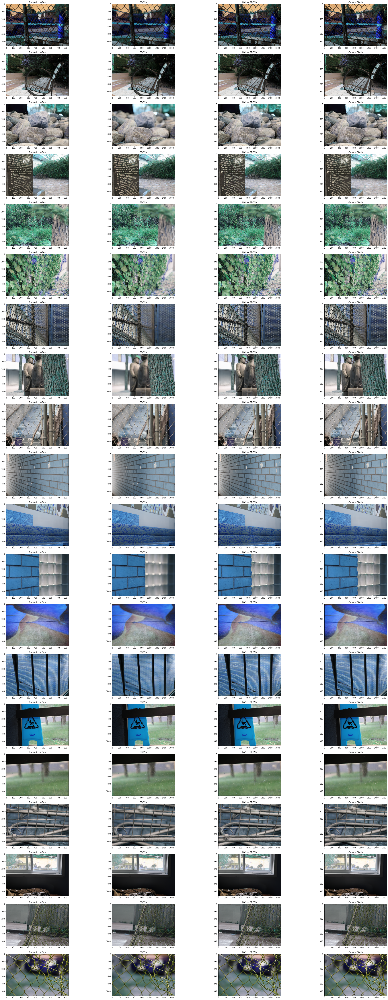

In [ ]:
# Preprocess the test images
print('Preprocessing test data ...')
cropped_test_images = []
lr_images = []
interpolated_images = []
preprocessed_test_images = []
hr_images = []
for image_no in range(to_display):
    image = dpdd_ifan_low_res_output_images[image_no]
    input_image = dpdd_ifan_low_res_input_images[image_no]

    H, W, _ = image.shape
    
    # Apply cubic interpilcation
    scale = 2.0
    H_high = int(H * scale)
    W_high = int(W * scale)

    interpolated_image = cv2.resize(input_image, dsize=(W_high, H_high), \
                                    fx=scale, fy=scale)
    interpolated_images.append(interpolated_image)

    output_interpolated_image = cv2.resize(image, dsize=(W_high, H_high), \
                                    fx=scale, fy=scale)

    # Rescale the image
    rescaled_image = output_interpolated_image / 1.

    # Swap axes
    axes_swapped_image = np.transpose(rescaled_image, (2, 0, 1))

    # Add an axes since the model takes 4d input
    processed_test_image = np.expand_dims(axes_swapped_image, axis=0)

    # Convert to PyToch tensor
    processed_tensor = torch.from_numpy(processed_test_image).float()

    # Add the processed image to the list
    preprocessed_test_images.append(processed_tensor)

    # Forward pass through SRCNN / Convert each test image to high-res using the SRCNN
    hr_tensor = model(processed_tensor)

    # Convert back to numpy array and adjust channels and scale
    hr_image = hr_tensor.detach().numpy()
    hr_image = np.transpose(hr_image, (0, 2, 3, 1))
    hr_image *= 1.
    hr_image = hr_image[0]

    hr_images.append(hr_image)

# Display examples
print('Plotting images')
f = plt.figure()
f.set_figheight(100)
f.set_figwidth(40)

rows = to_display

for i in range(rows):
    # Plot the LR and HR images
    ax_1 = plt.subplot(rows, 4, 4 * i + 1)
    plt.imshow(dpdd_ifan_low_res_output_images[i].astype('uint8'))
    ax_1.set_title('Blurred Lor-Res')

    ax_2 = plt.subplot(rows, 4, 4 * i + 2)
    plt.imshow(interpolated_images[i].astype('uint8'))
    ax_2.set_title('SRCNN') # Actually bicubic

    ax_3 = plt.subplot(rows, 4, 4 * i + 3)
    plt.imshow(hr_images[i].astype('uint8'))
    ax_3.set_title('IFAN + SRCNN')

    ax_4 = plt.subplot(rows, 4, 4 * i + 4)
    plt.imshow(dpdd_ifan_output_images[i].astype('uint8'))
    ax_4.set_title('Ground Truth')
plt.show()



In [ ]:
# Compare PSNR of simple bucubic imterpolation v/s SRCNN
bc_interpol_psnrs = []
srcnn_psnrs = []
crop_size = 1
for i in range(to_display):
    bc_interpol_psnrs.append(psnr(dpdd_ifan_output_images[:to_display][i], interpolated_images[i]))
    srcnn_psnrs.append(psnr(dpdd_ifan_output_images[:to_display][i], hr_images[i]))

for i in range(len(bc_interpol_psnrs)):
    print('Image No.: {}\tSRCNN: {}\t IFAN+SRCNN: {}'.format(i, bc_interpol_psnrs[i], srcnn_psnrs[i])

bc_interpol_psnr_avg = sum(bc_interpol_psnrs) / len(bc_interpol_psnrs)
srcnn_psnr_avg = sum(srcnn_psnrs) / len(srcnn_psnrs)

print('PSNR calculated over IFAN test set.')
print('Bicubic Interpolation: {:.8f}'.format(bc_interpol_psnr_avg))
print('SRCNN: {:.8f}'.format(srcnn_psnr_avg))

Image No.: 0	SRCNN: 23.306366425069424	 IFAN+SRCNN: 28.625362927776354
Image No.: 1	SRCNN: 25.497529186439092	 IFAN+SRCNN: 26.314988724928266
Image No.: 2	SRCNN: 21.222641300255233	 IFAN+SRCNN: 25.78841662537141
Image No.: 3	SRCNN: 20.1011227879265	 IFAN+SRCNN: 20.851617135446837
Image No.: 4	SRCNN: 20.676456301388487	 IFAN+SRCNN: 21.19712185768645
Image No.: 5	SRCNN: 22.878511105837287	 IFAN+SRCNN: 26.816559142204895
Image No.: 6	SRCNN: 20.42726656454798	 IFAN+SRCNN: 23.105810605218853
Image No.: 7	SRCNN: 17.47002331792656	 IFAN+SRCNN: 25.84253315382039
Image No.: 8	SRCNN: 24.12085059575606	 IFAN+SRCNN: 27.957414038943227
Image No.: 9	SRCNN: 28.734198735705313	 IFAN+SRCNN: 31.947598520751
Image No.: 10	SRCNN: 26.880531819473642	 IFAN+SRCNN: 26.26064646713995
Image No.: 11	SRCNN: 26.770540832641107	 IFAN+SRCNN: 35.184039274004284
Image No.: 12	SRCNN: 22.84691223843761	 IFAN+SRCNN: 22.809409806722407
Image No.: 13	SRCNN: 23.169136765377736	 IFAN+SRCNN: 27.572608708947726
Image No.: 14	S